# Tutorial on visualization of Neural Networks

Mail to: Thomas.alter@minesparis.psl.eu

Subject: IASD-VIS

Filename: yourname_yourfirstname_Visualization_ML_2025_torch.ipynb

This exercise aims at exploring different ways of visualizing Neural Networks:
- t-SNE of representations (CIFAR10)
- grad-CAM (ImageNet)
- activation maximization (ImageNet)

First, some preliminaries that facilitate plotting and data access on Google drive ... just execute !

In [1]:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib.colors import ListedColormap

plt.rcParams['figure.figsize'] = (20.0, 20.0)
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%matplotlib inline

import importlib.util
import sys

In [2]:
!pip install pytorch_lightning --quiet
!pip install transformers==4.46.1 --quiet


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 832.4/832.4 kB 21.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.2/983.2 kB 49.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.1/44.1 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.0/10.0 MB 52.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 38.2 MB/s eta 0:00:00


In [3]:
import torch
device = "cuda" if torch.cuda.is_available() else "cpu"

# Visualization of the encodings by t-SNE

First, we will visualize encodings of a network trained on the CIFAR data set. Here, we import and preprocess the data. We keep the original labels in `y_data` (to be used for visualization later on). For training, we need to transform them to one-hot-vectors.

In [4]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, random_split

# Load CIFAR-10 dataset
transform = transforms.Compose([
    transforms.ToTensor(),
    #transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))  # normalize to [-1, 1]
])

train_data = datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
test_data = datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)

# Separate training data into train and validation sets
train_size = 40000
val_size = len(train_data) - train_size
train_data, val_data = random_split(train_data, [train_size, val_size])

# Convert labels to one-hot encoding
def one_hot_encode(labels, num_classes=10):
    return torch.eye(num_classes)[labels]

# Load data into DataLoaders
train_loader = DataLoader(train_data, batch_size=64, shuffle=True)
val_loader = DataLoader(val_data, batch_size=64, shuffle=False)
test_loader = DataLoader(test_data, batch_size=64, shuffle=False)

100%|██████████| 170M/170M [00:13<00:00, 12.7MB/s]


We will first visualize the data.

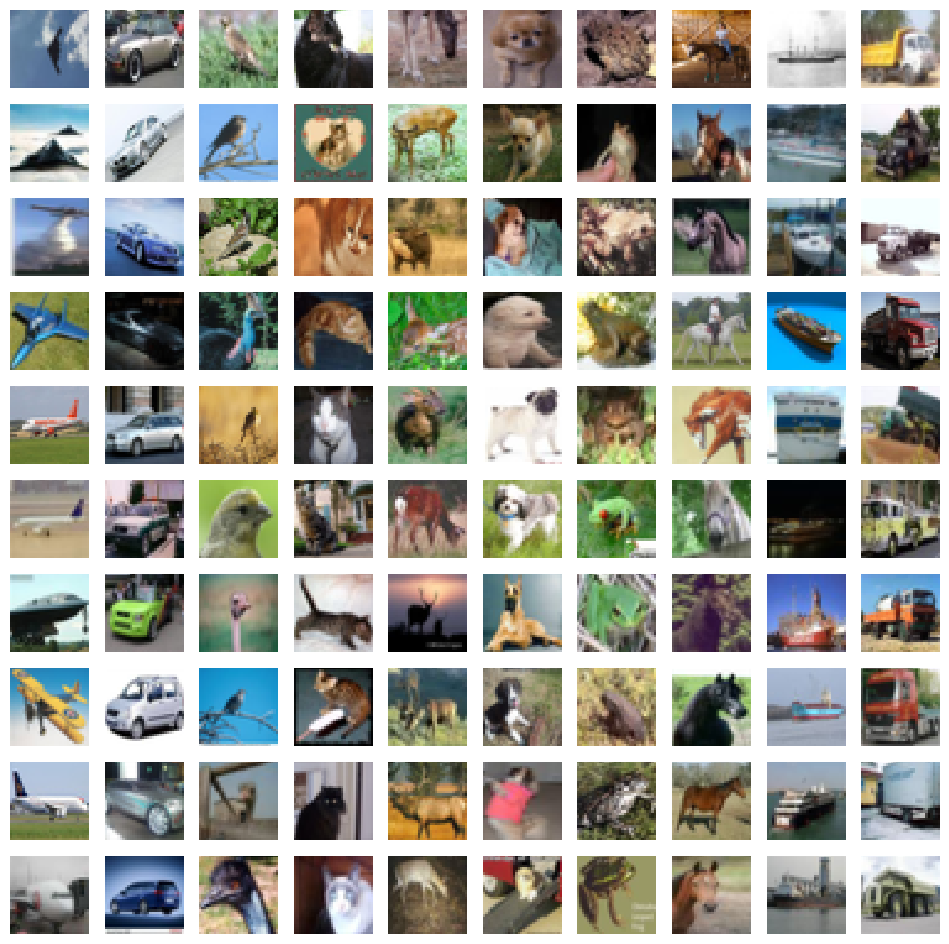

In [5]:
# helper function to plot a few images for each class
def plot_array(fig, dataset, classes_to_plot=None, samples_per_class=7):
    Y = dataset.targets
    if classes_to_plot is None:
        classes_to_plot = np.unique(Y)
    num_classes = len(classes_to_plot)

    for k, y in enumerate(classes_to_plot):
        idxs = np.flatnonzero(Y == y)
        idxs = np.random.choice(idxs, samples_per_class, replace=False)
        #print(y, idxs)

        for i, idx in enumerate(idxs):
            plt_idx = i * num_classes + k + 1
            ax = fig.add_subplot(samples_per_class, num_classes, plt_idx)
            image = dataset[idx][0].permute((1, 2, 0)) * 255
            ax.imshow(image.to(torch.uint8))
            ax.axis('off')
fig = plt.figure(figsize=(12, 12))
plot_array(fig, train_data.dataset, samples_per_class=10)

Next we define a neural network and train it on the data set. Here we use pytorch lightning to train the model using torch: https://lightning.ai/docs/pytorch/stable/starter/introduction.html

In [6]:
import torch
import torch.nn as nn
import torch.optim as optim
import pytorch_lightning as pl
from torchmetrics import Accuracy


class CNNModel(nn.Sequential):
    def __init__(self, num_class=10):
        super(CNNModel, self).__init__()
        # Feature extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.Conv2d(32, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),
            nn.Dropout(0.2),

            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),
            nn.Dropout(0.2),

            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),
            nn.Dropout(0.2),

            nn.AdaptiveAvgPool2d((1, 1)),  # Global average pooling
            nn.Flatten()
        )

        # Classifier
        self.classifier = nn.Sequential(
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(128, num_class)  # Output layer for 10 classes
        )

    def forward(self, x):
      embeddings = self.features(x)
      logits = self.classifier(embeddings)
      return logits

    def forward_features(self, x):
      return self.features(x)


# Define the Lightning Module
class LightningClassifier(pl.LightningModule):
    def __init__(self, model, learning_rate=0.001):
        super(LightningClassifier, self).__init__()
        self.model = model
        self.loss_fn = nn.CrossEntropyLoss()
        self.accuracy = Accuracy(task="multiclass", num_classes=10)
        self.learning_rate = learning_rate

    def forward(self, x):
        return self.model(x)

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = self.loss_fn(y_hat, y)
        acc = self.accuracy(y_hat.softmax(dim=-1), y)
        self.log('train_loss', loss, prog_bar=True)
        self.log('train_acc', acc, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = self.loss_fn(y_hat, y)
        acc = self.accuracy(y_hat.softmax(dim=-1), y)
        self.log('val_loss', loss, prog_bar=True)
        self.log('val_acc', acc, prog_bar=True)

    def test_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = self.loss_fn(y_hat, y)
        acc = self.accuracy(y_hat.softmax(dim=-1), y)
        self.log('test_loss', loss)
        self.log('test_acc', acc)

    def predict_step(self, batch, batch_idx):
        x, y = batch
        return self.model.forward_features(x)

    def configure_optimizers(self):
        return optim.Adam(self.parameters(), lr=self.learning_rate)

# Instantiate the Lightning model
torch.cuda.empty_cache()
model = CNNModel()
ligthning_model = LightningClassifier(model, learning_rate=0.001)
ligthning_model.to(device)

LightningClassifier(
  (model): CNNModel(
    (features): Sequential(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU()
      (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (7): Dropout(p=0.2, inplace=False)
      (8): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (9): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (10): ReLU()
      (11): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (12): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (13): ReLU()
      (14): MaxPool2d(kernel_size=2, stride=2, padding=0

In [7]:
import os
from pytorch_lightning.callbacks import ModelCheckpoint, LearningRateMonitor
from pytorch_lightning.loggers import TensorBoardLogger

# Train the model using the PyTorch Lightning Trainer
callbacks = [
    LearningRateMonitor(logging_interval="step"),
    ModelCheckpoint(
        dirpath=os.path.join("logs", "checkpoints"),
        filename="model",
        verbose=True,
        save_top_k=1,
        save_last=False,
        save_weights_only=True)]
logger = TensorBoardLogger("logs", name="classifier")

# where to store the best model (checkpoint)
best_checkpoint_path = os.path.join("logs", "checkpoints", "model.ckpt")

# trainer instantiation
trainer = pl.Trainer(
    max_epochs=10,
    callbacks=callbacks, logger=logger,
    accelerator="gpu" if device == "cuda" else "cpu",
    devices=1 if device == "cuda" else 0, # outside colab, you can increase the number of GPUs.
    gradient_clip_val=1., gradient_clip_algorithm="norm", # gradient clipping to improve stability
    precision="16" # half precision to speed up the training
    )

/usr/local/lib/python3.12/dist-packages/lightning_fabric/connector.py:571: `precision=16` is supported for historical reasons but its usage is discouraged. Please set your precision to 16-mixed instead!
INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [8]:
# This is how to train a lightning model
trainer.fit(ligthning_model, train_loader, val_loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/model_summary/model_summary.py:231: Precision 16-mixed is not supported by the model summary.  Estimated model size in MB will not be accurate. Using 32 bits instead.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name     | Type               | Params | Mode 
--------------------------------------------------------
0 | model    | CNNModel           | 305 K  | train
1 | loss_fn  | CrossEntropyLoss   | 0      | train
2 | accuracy | MulticlassAccuracy | 0      | train
--------------------------------------------------------
305 K     Trainable params
0         Non-trainable params
305 K     Total params
1.223     Total estimated model params size (MB)
35        Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


In [9]:
test_metrics = trainer.test(ligthning_model, test_loader, verbose=True, ckpt_path=best_checkpoint_path)

# to be sure that we loaded the best checkpoint
checkpoint = torch.load(best_checkpoint_path)
ligthning_model.load_state_dict(checkpoint["state_dict"], strict=True)

INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at logs/checkpoints/model.ckpt
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.utilities.rank_zero:Loaded model weights from the checkpoint at logs/checkpoints/model.ckpt


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.7965999841690063     │
│         test_loss         │    0.5951408743858337     │
└───────────────────────────┴───────────────────────────┘

<All keys matched successfully>

In [10]:
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

Now, that we trained the neural network, we observe training and validation error, and we try to get a solution that roughly obtains 80\% or more on the test set.

Now, we need to define a few plots ... just execute !

In [11]:
class_definition = {0: 'airplane', 1: 'automobile', 2: 'bird', 3: 'cat',
                    4: 'deer', 5: 'dog', 6: 'frog', 7: 'horse', 8: 'ship',
                    9: 'truck'}

from matplotlib.colors import to_hex

# definition of the scatterplot
def make_scatterplot(X, y, feature1=None, feature2=None,
                     class_indices=None, class_definition=None):
    if class_indices is None:
        class_indices = np.unique(y)
    if class_definition is None:
        class_definition = dict(zip(class_indices, [str(i) for i in class_indices]))
    if feature1 is None:
      feature1 = 'Component 1'
    if feature2 is None:
      feature2 = 'Component 2'

    # colors
    colors = plt.cm.get_cmap('tab10', 10).colors[:,:3]

    fig = plt.figure(figsize = (8,8))
    ax = fig.add_subplot(1,1,1)
    ax.set_xlabel(feature1)
    ax.set_ylabel(feature2)
    ax.set_title('Scatter plot: %s vs. %s' % (feature2, feature1))

    comp1 = X[:,0]
    comp2 = X[:,1]
    for class_index in class_indices:
        class_label = class_definition[class_index]
        ax.scatter(comp1[y==class_index],
                   comp2[y==class_index],
                   c=to_hex(colors[class_index]),
                   label=class_label,
                   s=15)
    ax.legend()
    ax.grid()

Now, we will extract the features of a layer and visualize the distribution of the encodings with t-SNE.

First, we start with layer `flatten`. This is the last layer before the dense layers in the network.

In [12]:
model = ligthning_model.model.eval().to(device)


# features_upstream and features_downstream will hold the two feature
# vectors we are going to look at later.
features_upstream = []
features_downstream = []
y = []
for data in val_loader:
  x_batch, y_batch = data
  y.append(y_batch)
  with torch.no_grad():

    # try to understand what is happening here.
    features_batch = model.features(x_batch.to(device))
    features_batch_ds = model.classifier[1](model.classifier[0](features_batch))

  features_upstream.append(features_batch.cpu())
  features_downstream.append(features_batch_ds.cpu())

# output --> vector
y = torch.hstack(y).numpy()

# we consider a subsample of the entire dataset
idxs_sampled = np.random.choice(np.arange(len(y)), 2000, replace=False)

# output subsampling
y = y[idxs_sampled]

# we choose whether to use features_upstream or features_downstream
features = torch.vstack(features_upstream).numpy()
features = features[idxs_sampled]


Finally, we perform t-SNE.

/tmp/ipython-input-3877127856.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', 10).colors[:,:3]


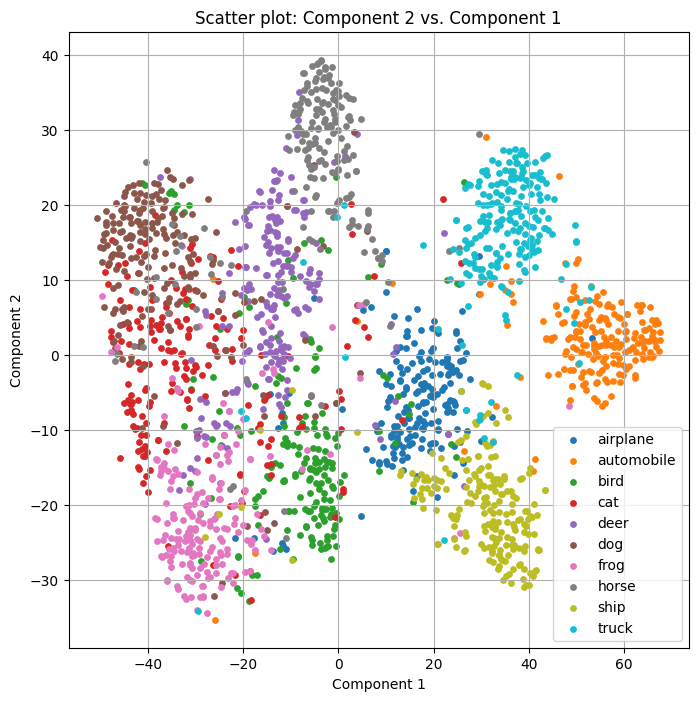

In [13]:
from sklearn.manifold import TSNE
X_embedded = TSNE(n_components=2, perplexity=30).fit_transform(features)
make_scatterplot(X_embedded, y.flatten(), class_definition=class_definition)

/tmp/ipython-input-3877127856.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', 10).colors[:,:3]


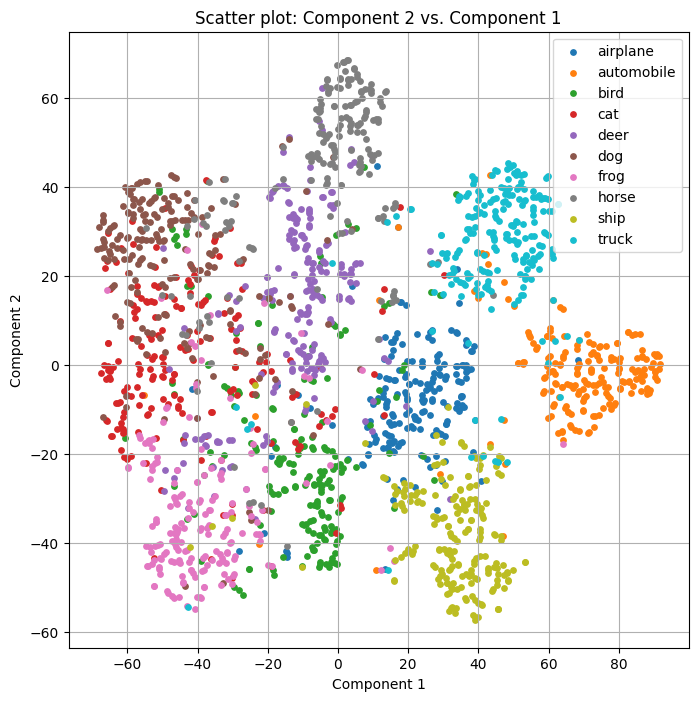

In [14]:
X_embedded = TSNE(n_components=2, perplexity=10).fit_transform(features)
make_scatterplot(X_embedded, y.flatten(), class_definition=class_definition)

/tmp/ipython-input-3877127856.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', 10).colors[:,:3]


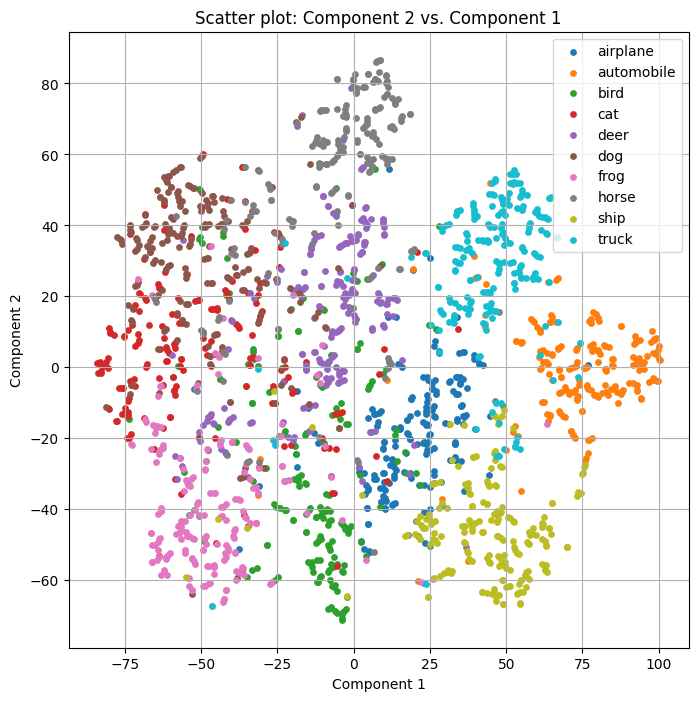

In [15]:
X_embedded = TSNE(n_components=2, perplexity=5).fit_transform(features)
make_scatterplot(X_embedded, y.flatten(), class_definition=class_definition)

**Assignment**: Explain what is a feature vector (hint: other terms in the literature are "Encodings", "Embeddings")

**Answer:** A feature vector is a numeric representation of an input (like an image) extracted from a neural network, usually from one of its intermediate layers.

**Assignment**: Try out several perplexities: 5, 10, 30. What do you observe?

**Answer:** When you change the perplexity parameter to values like 5, 10, and 30, you notice some clear differences. A lower perplexity emphasizes small groups of points, making them look more separated. In contrast, a higher perplexity reveals larger patterns, where clusters may blend together, and boundaries can appear unclear. This adjustment helps to see how detailed the neighborhood structure looks.

**Assignment**: Visualize now the embeddings at the two fully connected layers (in a different cell). Do you observe differences (albeit subtle)? Imagine you would like to use the same representations in another project (same image size, but other classes). Which of the representations seems more useful? Why?

**Answer:** When we visualize t-SNE plots from the two fully connected layers, we notice some differences. Features from the first dense layer are usually more general and less specialized, while features from the last dense layer focus more on distinguishing between classes, so they are better seperable because they tend  to optimize to be distinctive. But, if we want to transfer this to another project that uses the same image size but has different classes, the earlier layer's representations are generally more useful. They capture broad, reusable features instead of being closely tailored to the specific CIFAR-10 categories.




In [16]:
model = ligthning_model.model.eval().to(device)


# features_upstream and features_downstream will hold the two feature
# vectors we are going to look at later.
features_upstream = []
features_downstream = []
y = []
for data in val_loader:
  x_batch, y_batch = data
  y.append(y_batch)
  with torch.no_grad():

    # try to understand what is happening here.
    features_batch = model.features(x_batch.to(device))
    features_batch_ds = model.classifier[1](model.classifier[0](features_batch))

  features_upstream.append(features_batch.cpu())
  features_downstream.append(features_batch_ds.cpu())

# output --> vector
y = torch.hstack(y).numpy()

# we consider a subsample of the entire dataset
idxs_sampled = np.random.choice(np.arange(len(y)), 2000, replace=False)

# output subsampling
y = y[idxs_sampled]

# we choose whether to use features_upstream or features_downstream
features = torch.vstack(features_downstream).numpy()
features = features[idxs_sampled]

/tmp/ipython-input-3877127856.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', 10).colors[:,:3]


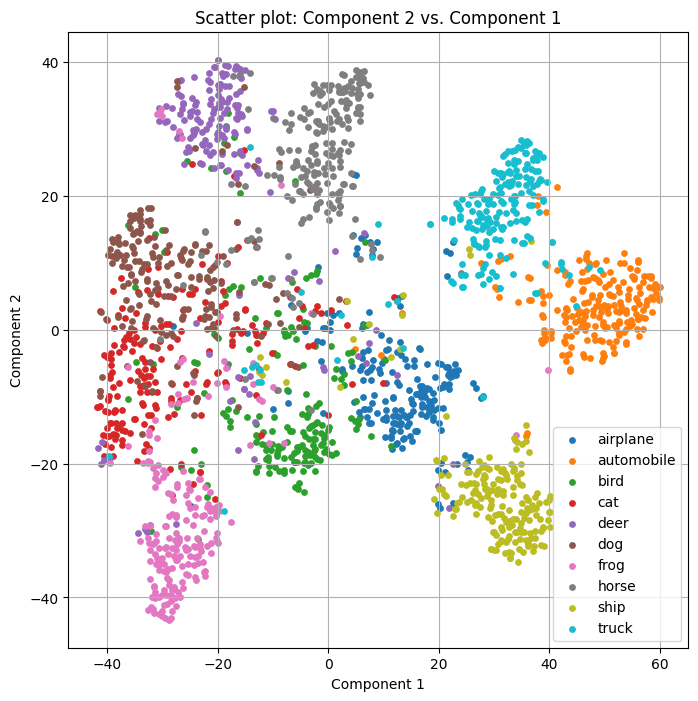

In [17]:
X_embedded = TSNE(n_components=2, perplexity=30).fit_transform(features)
make_scatterplot(X_embedded, y.flatten(), class_definition=class_definition)

**Assignment**: Visualize the tSNE plot of the untrained embeddings (model output before training). What do you observe?

**Answer:** When we look at features from a model that hasn't been trained yet, t-SNE plots show no clear groupings. This means that the network has not learned how to organize the input data into separate patterns for classification.


In [18]:
untrained_model = CNNModel()
untrained_ligthning_model = LightningClassifier(untrained_model, learning_rate=0.001)
untrained_ligthning_model.to(device)
untrained_model.eval()

features_untrained = []
y_untrained = []
for data in val_loader:
    x_batch, y_batch = data
    y_untrained.append(y_batch)
    with torch.no_grad():
        features_batch = untrained_model.features(x_batch.to(device))
    features_untrained.append(features_batch.cpu())

y_untrained = torch.hstack(y_untrained).numpy()

idxs_sampled_untrained = np.random.choice(np.arange(len(y_untrained)), 2000, replace=False)
y_untrained = y_untrained[idxs_sampled_untrained]
features_untrained = torch.vstack(features_untrained).numpy()
features_untrained = features_untrained[idxs_sampled_untrained]



/tmp/ipython-input-3877127856.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', 10).colors[:,:3]


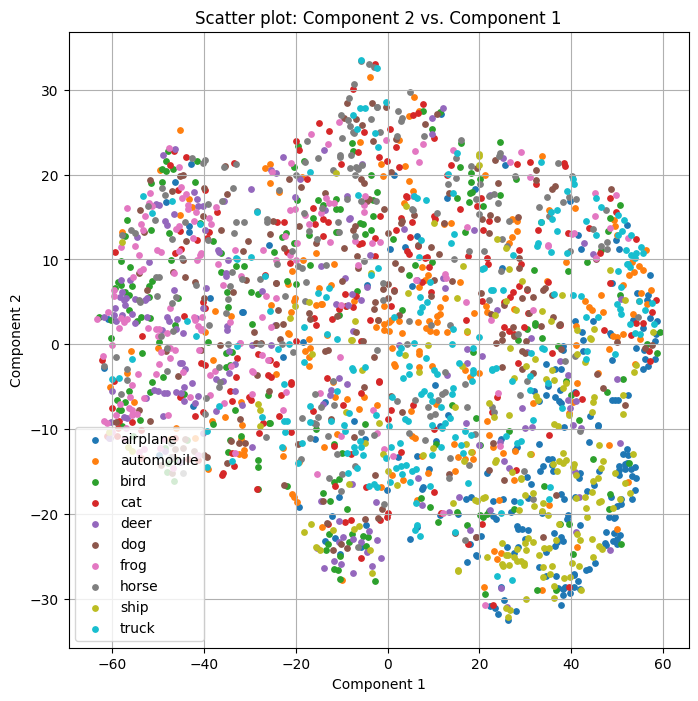

In [19]:
# Perform t-SNE and plot the embeddings
X_embedded_untrained = TSNE(n_components=2, perplexity=30).fit_transform(features_untrained)
make_scatterplot(X_embedded_untrained, y_untrained.flatten(), class_definition=class_definition)

# Classification activation maps (grad-CAM)

Classification activation maps provide certainly the most popular visualization methods for network inspection.

In [20]:
import torch
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

In [21]:
!pip install gdown
!gdown --id 1-ypc0JK1Hp4d3dfO6eq0mPcx669PthXw --output /content/imagenet.zip
!unzip -q /content/imagenet.zip
!rm /content/imagenet.zip

/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1-ypc0JK1Hp4d3dfO6eq0mPcx669PthXw
To: /content/imagenet.zip
100% 1.72M/1.72M [00:00<00:00, 169MB/s]


In [22]:
!pip install torchcam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 70.3 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
opencv-python-headless 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
opencv-python 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
opencv-contrib-python 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you h

Next, we will load VGG16, pretrained on `ImageNet`. This is the network we are going to investigate.

In [23]:
from torchvision import models
import torch.nn.functional as F

torch.cuda.empty_cache()
model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1)
model = model.eval().to(device)

labels_names = models.VGG16_Weights.IMAGENET1K_V1.meta["categories"]

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


100%|██████████| 528M/528M [00:05<00:00, 110MB/s] 


Now, we load an image from the `ImageNet` data base. We have downloaded these images: they are in the folder `imagenet`.

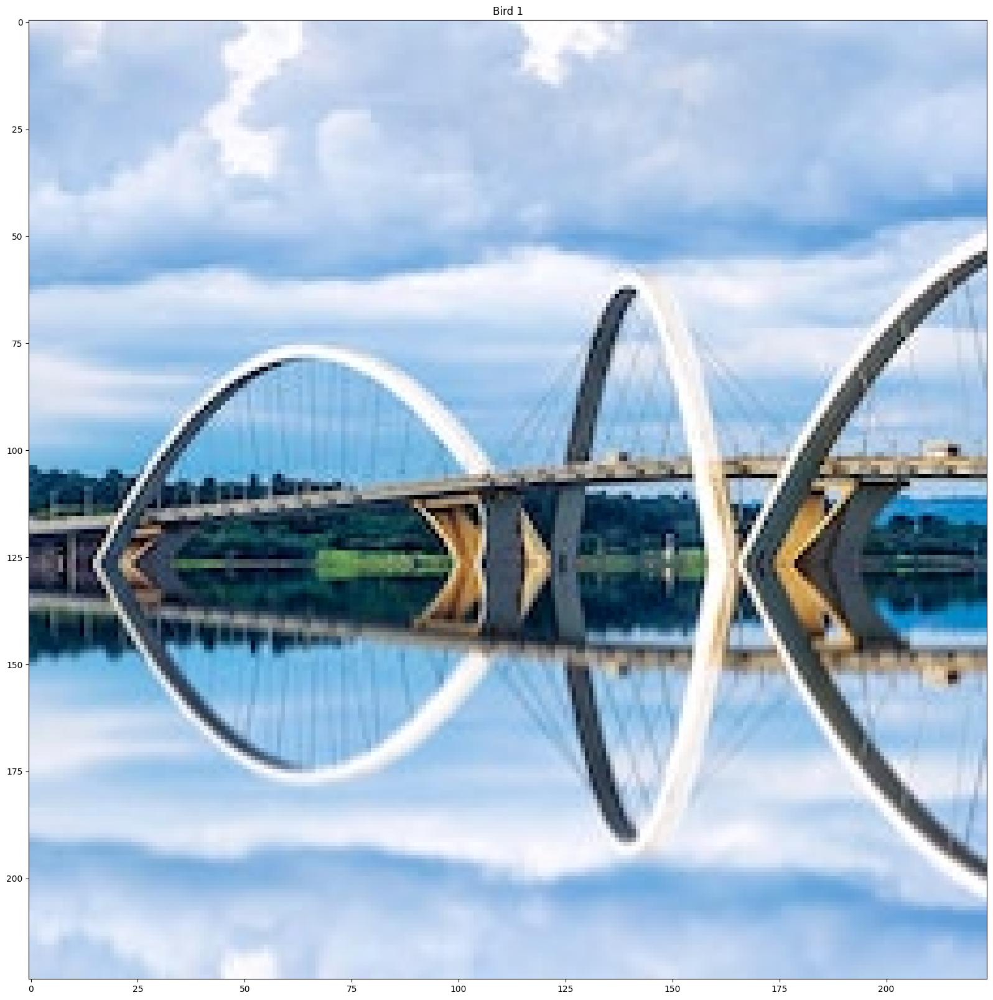

In [24]:
import os
from PIL import Image

filename = 'bridge2.jpg'
folder_name = '/content/imagenet'

# animals:
# bird : filename = '418657219_3567961db1.jpg'
# dog : filename = '425248370_b15374000e.jpg'
# bird : filename = '485627874_8f4144223a.jpg'

# bridges:
# filename = 'bridge1.jpg'
# filename = 'bridge2.jpg'
# filename = 'bridge3.jpg'

image = Image.open(os.path.join(folder_name, filename)).resize((224, 224))
plt.title('Bird 1')
plt.imshow(image)


Now, we will predict the label of the image.

In [25]:
from torchvision import transforms


preprocess = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225])  # Normalize to match ImageNet
])

img_prep = preprocess(image)
img_prep = img_prep.unsqueeze(0)

with torch.no_grad():
    img_prediction = model(img_prep.to(device))

# Get probabilities by applying softmax to the output
probs = F.softmax(img_prediction, dim=1)

# Convert the probabilities to a numpy array and get the top 3 predictions
top_probs, top_indices = torch.topk(probs, 3, dim=1)
top_probs = top_probs.squeeze().cpu().numpy()
top_indices = top_indices.squeeze().cpu().numpy()

for i in range(3):
    label = labels_names[top_indices[i]]
    print(f"{label} ({top_indices[i]}): {top_probs[i] * 100:.2f}%")

# Get the solution index with the maximum probability
max_index = top_indices[0]
print('Predicted Index:', max_index)

steel arch bridge (821): 66.78%
bicycle-built-for-two (444): 6.95%
sunglasses (837): 5.86%
Predicted Index: 821


We will use the [Grad-Cam++](https://arxiv.org/pdf/1710.11063) implementation from torch-cam https://github.com/frgfm/torch-cam

Note that the output of the model needs to be the the logits and not probabilities (default behaviour in torchvision mdeols). The reason is that with `softmax` we cannot study the influence of neurons on the output $y_k$, if the output depends on all classes (which is the case when we use `softmax`).

821


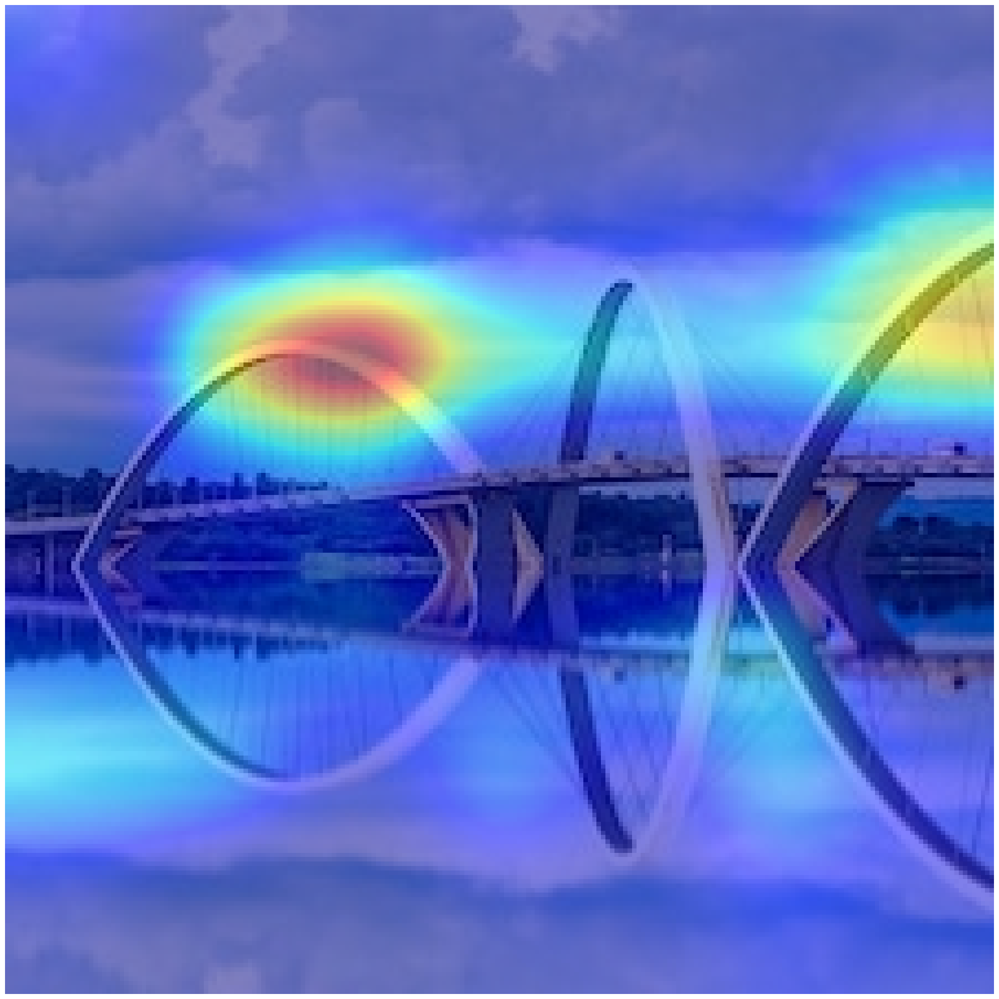

444


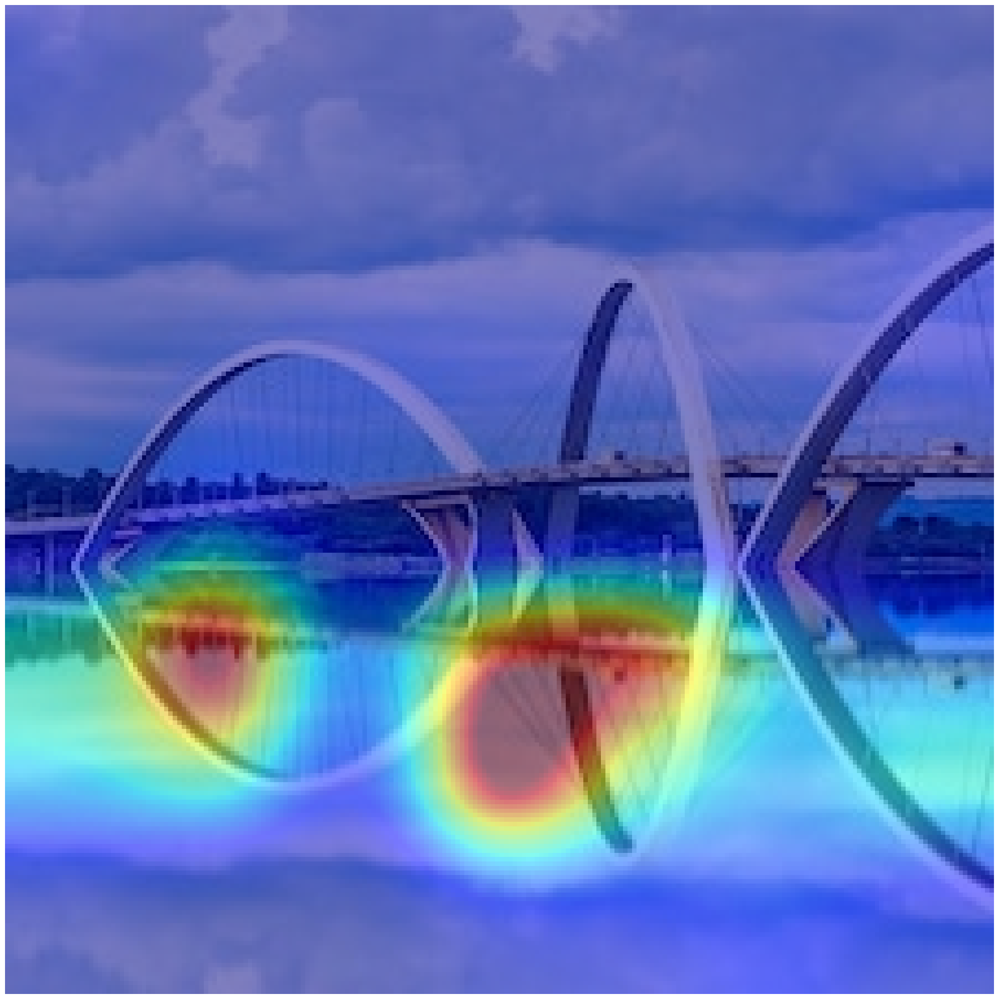

837


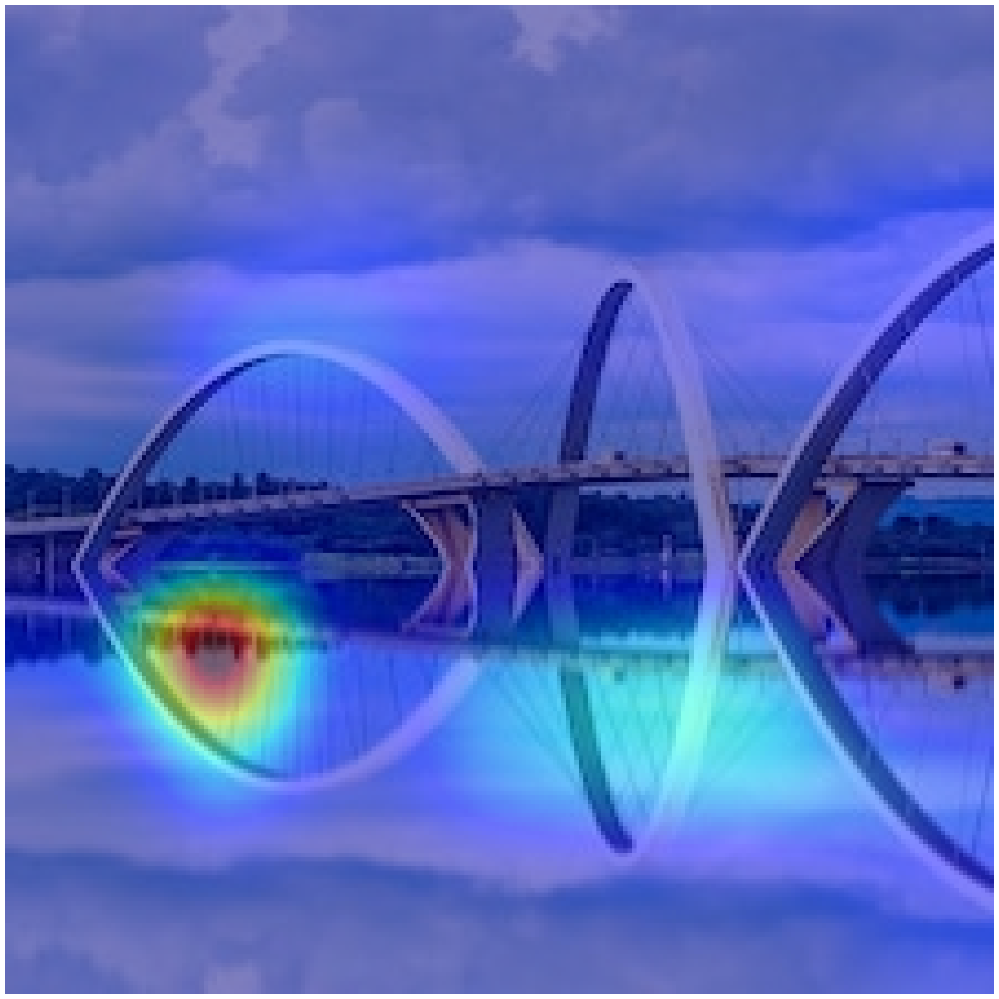

In [26]:
from torchcam.methods import GradCAMpp
from torchcam.utils import overlay_mask
from torchvision.transforms.functional import to_pil_image

n=3

img_prep = preprocess(image)
img_prep = img_prep.unsqueeze(0)

for k in range(n):
  with GradCAMpp(model) as cam_extractor:
      # Preprocess your data and feed it to the model
      out = model(img_prep.to(device))
      # Retrieve the CAM by passing the class index and the model output
      indices = out.squeeze(0).topk(n).indices
      print(int(indices[k]))
      activation_map = cam_extractor(int(indices[k]), out)

      # Resize the CAM and overlay it
      result = overlay_mask(image, to_pil_image(activation_map[0].squeeze(0), mode='F'), alpha=0.5)
      # Display it
      plt.imshow(result); plt.axis('off'); plt.tight_layout(); plt.show()

**Assignment:** Test the grad-CAM first on the three animal images, and verify that you obtain a reasonable result. Then test the algorithm on the three bridge images. Visualize the top-3 predictions.(Make a nice plot with the results)

*   For `Bridge1.jpg` you obtain a wrong classification, but what can be said about the learned network in view of the visualization of the top-3 predictions?

**Answer:** Although, the predcition is wrong for those top three predictions and the model could not calssify the bridge, but the parts that after visualization we can see that it focus on looks similar to the category that is wrongly assigned by the model (for the first part the red focus part looks like a schooner actually and simialrly for the second and third part)


*   For `Bridge2.jpg` you get the right result, but what can you say about the "understanding" of the image in view of your visualization result?

**Answer:** Althogh, the prediction is correct but the visualization seems not correctly focusing on the bridge itslef and capturing the bridge structral properties well.

Note that the correspondence of class names and indices can be found at:
[ImageNet](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a)


### Animal Images Grad-CAM Visualizations ###


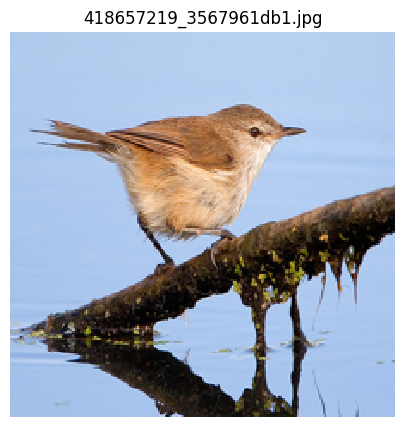

Top-3 predictions for 418657219_3567961db1.jpg:
  water ouzel (20): 97.20%
  jay (17): 0.65%
  red-backed sandpiper (140): 0.64%


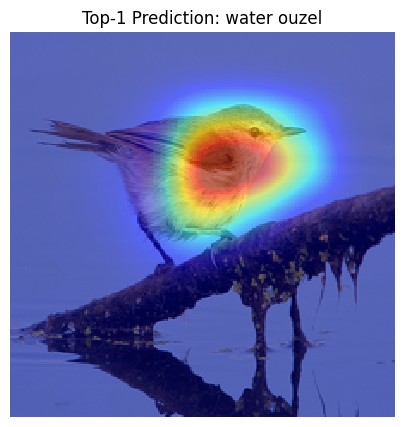

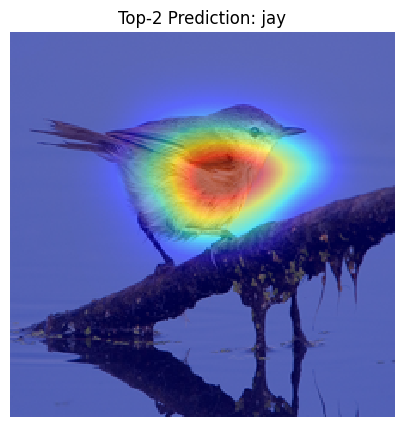

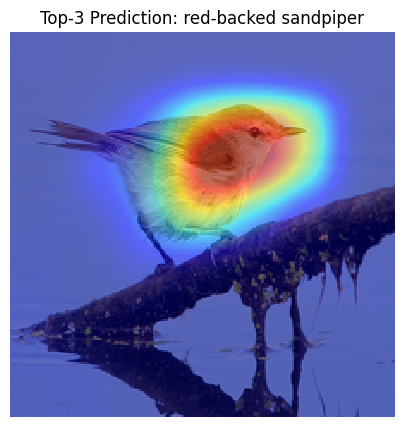

------------------------------------------------------------


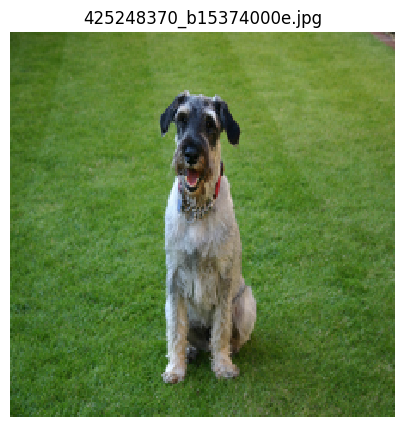

Top-3 predictions for 425248370_b15374000e.jpg:
  standard schnauzer (198): 72.13%
  miniature schnauzer (196): 20.36%
  giant schnauzer (197): 3.52%


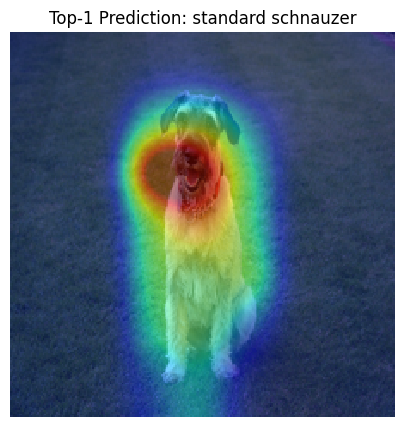

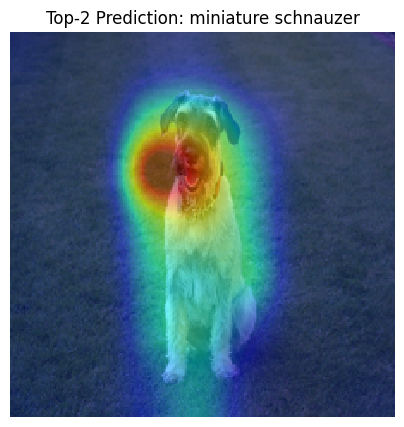

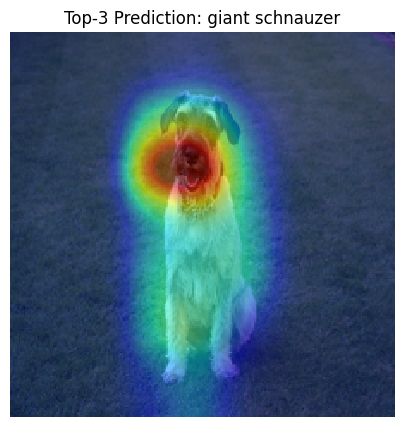

------------------------------------------------------------


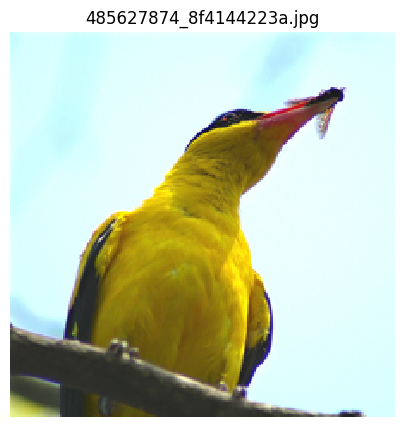

Top-3 predictions for 485627874_8f4144223a.jpg:
  bee eater (92): 81.24%
  macaw (88): 13.22%
  bulbul (16): 1.88%


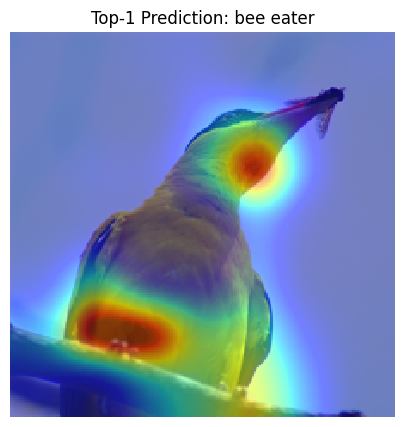

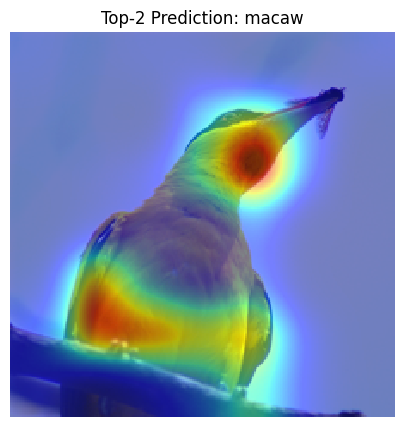

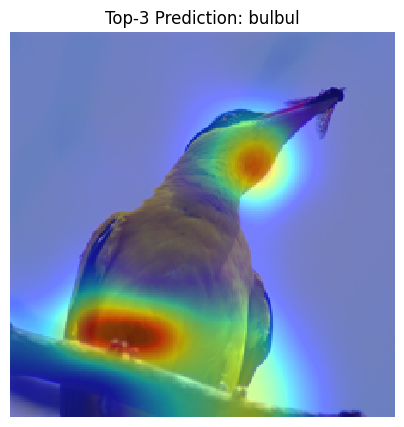

------------------------------------------------------------
------------------------------------------------------------
### Bridge Images Grad-CAM Visualizations ###


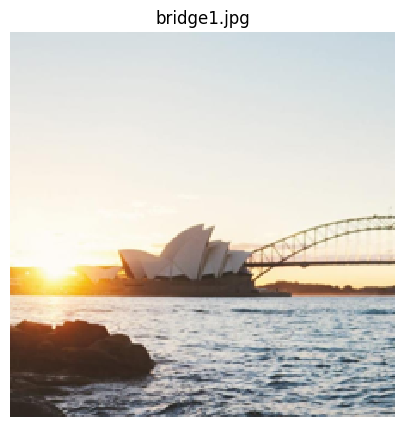

Top-3 predictions for bridge1.jpg:
  schooner (780): 27.15%
  pier (718): 10.60%
  wreck (913): 9.71%


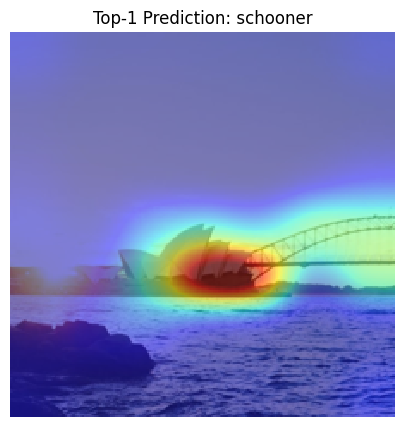

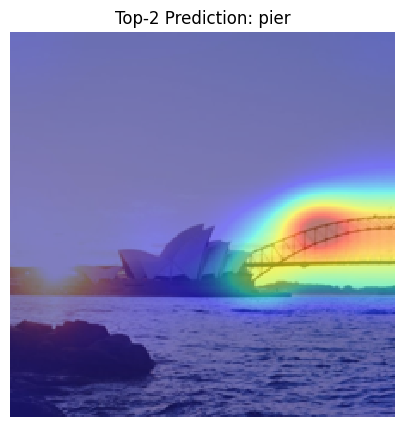

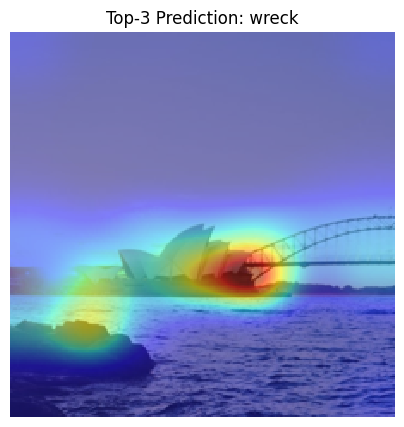

------------------------------------------------------------


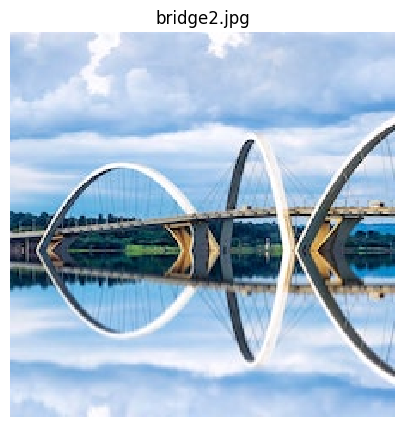

Top-3 predictions for bridge2.jpg:
  steel arch bridge (821): 66.78%
  bicycle-built-for-two (444): 6.95%
  sunglasses (837): 5.86%


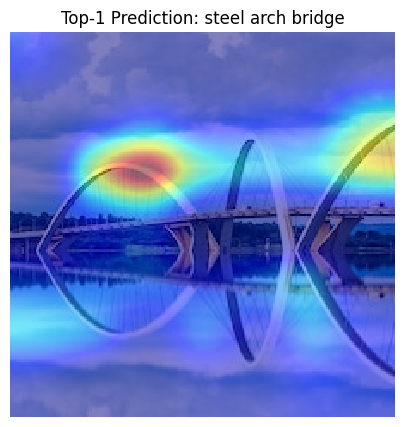

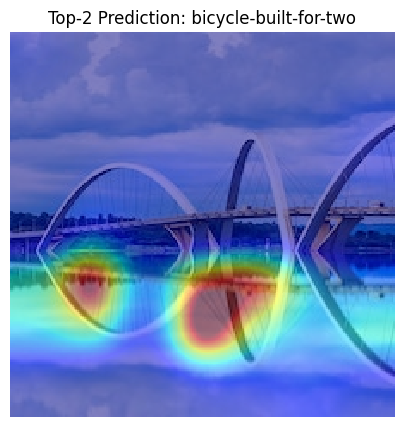

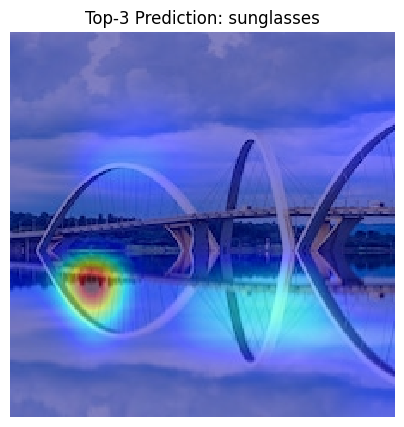

------------------------------------------------------------


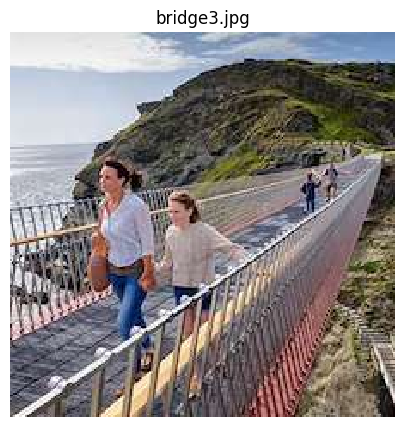

Top-3 predictions for bridge3.jpg:
  suspension bridge (839): 71.03%
  pier (718): 13.15%
  dam (525): 5.00%


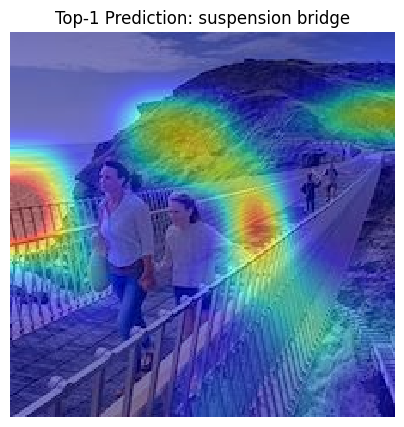

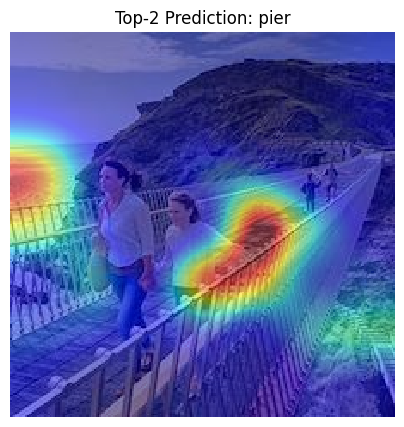

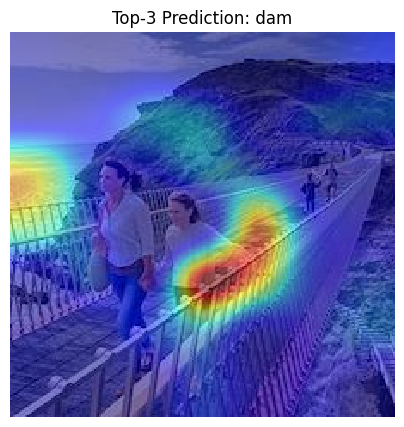

------------------------------------------------------------


In [27]:
import matplotlib.pyplot as plt
from torchvision import transforms
import torch.nn.functional as F

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1)
model = model.eval().to(device)
labels_names = models.VGG16_Weights.IMAGENET1K_V1.meta["categories"]

preprocess = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225]),
])

# Lists of animal and bridge image filenames
animal_images = ['418657219_3567961db1.jpg', '425248370_b15374000e.jpg', '485627874_8f4144223a.jpg']
bridge_images = ['bridge1.jpg', 'bridge2.jpg', 'bridge3.jpg']

folder_name = '/content/imagenet'

def visualize_gradcam_on_image(filename):
    image_path = os.path.join(folder_name, filename)
    image = Image.open(image_path).convert('RGB').resize((224, 224))

    plt.figure(figsize=(5,5))
    plt.title(filename)
    plt.imshow(image)
    plt.axis('off')
    plt.show()

    img_prep = preprocess(image).unsqueeze(0)

    with torch.no_grad():
        output = model(img_prep.to(device))
        probs = F.softmax(output, dim=1)
        top_probs, top_indices = torch.topk(probs, 3, dim=1)

    top_probs = top_probs.squeeze().cpu().numpy()
    top_indices = top_indices.squeeze().cpu().numpy()

    print(f"Top-3 predictions for {filename}:")
    for i in range(3):
        label = labels_names[top_indices[i]]
        print(f"  {label} ({top_indices[i]}): {top_probs[i]*100:.2f}%")

    # GradCAM++ Overlay visualization for each top-3 class
    with GradCAMpp(model) as cam_extractor:
        out = model(img_prep.to(device))
        for i in range(3):
            activation_map = cam_extractor(int(top_indices[i]), out, retain_graph=True)
            result = overlay_mask(image, to_pil_image(activation_map[0].squeeze(0), mode='F'), alpha=0.5)

            plt.figure(figsize=(5,5))
            plt.title(f'Top-{i+1} Prediction: {labels_names[top_indices[i]]}')
            plt.imshow(result)
            plt.axis('off')
            plt.show()

print("### Animal Images Grad-CAM Visualizations ###")
for img_file in animal_images:
    visualize_gradcam_on_image(img_file)
    print(60*"-")

print(60*"-")

print("### Bridge Images Grad-CAM Visualizations ###")
for img_file in bridge_images:
    visualize_gradcam_on_image(img_file)
    print(60*"-")

# Activation Maximization

So far, we visualized activations of images, i.e. we focused on visualizations of inner network representations for given image data.

We can also visualize properties of the network itself. A popular method is the activation maximization, where we seek an image that would maximize a given neuron inside the network.

For this, we solve the maximization problem:
\begin{equation}
x^{\ast} = {\arg \max}_{x} z(x)
\end{equation}
where $z(x)$ is the value of an arbitrary neuron (or a set of neurons, e.g. the neurons in one feature map) in the network.

Typically, $z(x)=S_c(x)$ is the value of the output layer for one particular class. We therefore seek the image that maximizes the output for a particular class (e.g. the output for `water_ouzel`, `index: 20`).

More information here: https://distill.pub/2017/feature-visualization/

In [28]:
#@title Maximum activation visualization functions

# Inspired from  tf-keras-vis https://github.com/keisen/tf-keras-vis/blob/c793148ff6bc97d03880b107b958fb9c4f87efc5/tf_keras_vis/activation_maximization/__init__.py#L17

import torch.nn as nn
import numpy as np


class TotalVariation2D(nn.Module):
    """A regularizer that introduces Total Variation."""

    def __init__(self, weight=10.0, name='TotalVariation2D'):
        """
        Args:
            weight: This value will be applied to TotalVariation values.
                Defaults to 10.0.
            name : Instance name.
                Defaults to 'TotalVariation2D'.
        """
        super(TotalVariation2D, self).__init__()
        self.weight = float(weight)

    def forward(self, input_value):
        if len(input_value.shape) != 4:
            raise ValueError("Input shape must be (batch_size, channels, height, width), "
                             f"but was {input_value.shape}.")

        # Calculate total variation
        tv = torch.sum(torch.abs(input_value[:, :, 1:, :] - input_value[:, :, :-1, :])) + \
             torch.sum(torch.abs(input_value[:, :, :, 1:] - input_value[:, :, :, :-1]))

        # Normalize by the number of elements and apply weight
        tv /= float(input_value.shape[1] * input_value.shape[2] * input_value.shape[3])
        tv *= self.weight
        return tv


class Norm(nn.Module):
    """A regularizer that introduces Norm."""

    def __init__(self, weight=10.0, p=2, name='Norm'):
        """
        Args:
            weight: This weight will be applied to the norm values.
                Defaults to 10.
            p: Order of the norm. Defaults to 2.
            name: Instance name. Defaults to 'Norm'.
        """
        super(Norm, self).__init__()
        self.weight = float(weight)
        self.p = int(p)

    def forward(self, input_value):
        # Reshape to (batch_size, -1) for calculating norm
        reshaped_input = input_value.view(input_value.shape[0], -1)

        # Compute the norm along the specified dimension
        norm = torch.norm(reshaped_input, p=self.p, dim=1)

        # Normalize without in-place operations
        norm = norm / (reshaped_input.shape[1] ** (1.0 / float(self.p)))
        norm = norm * self.weight

        # Return the norm as a scalar by taking the mean
        return norm.mean()


class Jitter:
    """An input modifier that introduces random jitter.
       Jitter has been shown to produce crisper activation maximization images.
    """

    def __init__(self, jitter=8):
        """
        Args:
            jitter: The amount of jitter to apply. Defaults to 8.
        """
        self.jitter = int(jitter)

    def __call__(self, seed_input):
        ndim = len(seed_input.shape)
        if ndim < 3:
            raise ValueError("The dimensions of seed_input must be 3 or more "
                             f"(batch_size, ..., channels), but was {ndim}.")

        # Generate random shifts within the jitter range for each spatial dimension
        shifts = tuple(np.random.randint(-self.jitter, self.jitter) for _ in range(ndim - 2))
        axes = tuple(range(1, ndim - 1))  # Apply shifts to all spatial dimensions

        # Apply torch.roll to create jitter
        seed_input = torch.roll(seed_input, shifts=shifts, dims=axes)

        return seed_input


class Rotate2D:
    """An input modifier for 2D that introduces random rotation."""

    def __init__(self, degree=3.0):
        """
        Args:
            degree: The maximum degree of rotation to apply.
        """
        self.degree = float(degree)
        self.random_generator = np.random.default_rng()

    def __call__(self, seed_input):
        # Check input dimensions
        if len(seed_input.shape) != 4:
            raise ValueError("Input shape must be (batch_size, channels, height, width), "
                             f"but was {seed_input.shape}.")

        # Get a random rotation angle within the specified range
        angle = self.random_generator.uniform(-self.degree, self.degree)

        # Rotation requires transformation matrix
        theta = torch.tensor([
            [torch.cos(torch.tensor(angle * np.pi / 180)), -torch.sin(torch.tensor(angle * np.pi / 180)), 0],
            [torch.sin(torch.tensor(angle * np.pi / 180)),  torch.cos(torch.tensor(angle * np.pi / 180)), 0]
        ], dtype=seed_input.dtype, device=seed_input.device)

        # Expand to a batch of transformation matrices
        theta = theta.unsqueeze(0).repeat(seed_input.size(0), 1, 1)

        # Create affine grid for rotation and apply it with grid_sample
        grid = F.affine_grid(theta, seed_input.size(), align_corners=False)
        rotated_input = F.grid_sample(seed_input, grid, align_corners=False, padding_mode='reflection')

        return rotated_input



class ActivationMaximization:
    def __init__(self, model, lr=5e-2, plot_iterations=100):
        """
        Args:
            model: The neural network model.
            neuron_index: Index of the neuron to visualize.
            input_shape: Shape of the input image. Defaults to (224, 224).
            lr: Learning rate for optimization. Defaults to 5e-2.
            tv_loss_weight: Weight for the total variation loss. Defaults to 1e-5.
            num_iterations: Number of iterations for activation maximization. Defaults to 4000.
            plot_iterations: Number of iterations between plot updates. Defaults to 100.
        """
        self.model = model
        self.lr = lr
        self.total_var = TotalVariation2D(weight=5.)
        self.norm = Norm(weight=1.)
        self.jitter_transform = Jitter(jitter=4)
        self.rotate = Rotate2D(degree=1.)
        self.plot_iterations = plot_iterations
        self.to_pil = transforms.ToPILImage()

        device = "cuda" if torch.cuda.is_available() else "cpu"
        self.mean_imagenet = torch.tensor([0.485, 0.456, 0.406]).view((1, 3, 1, 1)).to(device)
        self.std_imagenet = torch.tensor([0.229, 0.224, 0.225]).view((1, 3, 1, 1)).to(device)

    @staticmethod
    def total_variation_loss(x):
        """Calculates the total variation loss for an input tensor."""
        tv_loss = torch.sum(torch.abs(x[:, :, 1:, :] - x[:, :, :-1, :])) + \
                  torch.sum(torch.abs(x[:, :, :, 1:] - x[:, :, :, :-1]))
        return tv_loss

    def apply_norm(self, x):
        """Applies normalization to the input tensor (if necessary)."""
        # Placeholder for normalization; adjust as needed for your model
        return (x - self.mean_imagenet) / self.std_imagenet

    def visualize(self, neuron_index, input_shape=(224, 224), num_iterations=2000):
        tensor_shape = (1, 3) + input_shape
        input_tensor = torch.randn(tensor_shape, requires_grad=True, device="cuda")
        #optimizer = torch.optim.Adam([input_tensor], lr=self.lr)
        optimizer = torch.optim.RMSprop([input_tensor], lr=self.lr, alpha=0.999)

        # Activation Maximization Loop
        for i in range(num_iterations):
            optimizer.zero_grad()

            # Forward pass for neuron activation
            with torch.no_grad():
                input_tensor.copy_(self.jitter_transform(input_tensor))
                input_tensor.copy_(self.rotate(input_tensor))
            neuron_activation = self.model(self.apply_norm(input_tensor))[..., neuron_index]
            activation_loss = -neuron_activation.mean()  # Negative to maximize

            # Total variation loss
            total_var = self.total_var(input_tensor)
            norm = self.norm(input_tensor)
            regularizer_loss = total_var + norm
            loss = activation_loss + regularizer_loss

            # Backward and optimize
            loss.backward()
            optimizer.step()

            # Clamp values to the display range [0, 1]
            input_tensor.data = torch.clamp(input_tensor.data, 0, 1)

            # Logging or visualization step
            if i % self.plot_iterations == 0:
                print(f"Iteration {i}/{num_iterations}, Activation: {-activation_loss.item()}, TotalVar: {total_var.item()}, TotalVar: {norm.item()}")

        # Display the final maximized image
        optimized_image = input_tensor.squeeze().cpu().detach().clamp(0, 1)
        plt.imshow(self.to_pil(optimized_image))
        plt.title(f"Activation Maximization for Neuron {neuron_index}")
        plt.axis("off")
        plt.show()

Iteration 0/2000, Activation: 1.195575475692749, TotalVar: 5.854308128356934, TotalVar: 0.6369107365608215
Iteration 100/2000, Activation: 6.929081916809082, TotalVar: 1.5095796585083008, TotalVar: 0.5498484969139099
Iteration 200/2000, Activation: 12.6535062789917, TotalVar: 1.8340580463409424, TotalVar: 0.5576835870742798
Iteration 300/2000, Activation: 18.574600219726562, TotalVar: 1.2268223762512207, TotalVar: 0.5401046276092529
Iteration 400/2000, Activation: 37.73186111450195, TotalVar: 1.1547932624816895, TotalVar: 0.5389630198478699
Iteration 500/2000, Activation: 52.795040130615234, TotalVar: 1.1420109272003174, TotalVar: 0.5387018322944641
Iteration 600/2000, Activation: 59.80226135253906, TotalVar: 1.0888943672180176, TotalVar: 0.5398963093757629
Iteration 700/2000, Activation: 102.83800506591797, TotalVar: 1.134111762046814, TotalVar: 0.5426397323608398
Iteration 800/2000, Activation: 119.09383392333984, TotalVar: 1.2539408206939697, TotalVar: 0.5433973073959351
Iteration 9

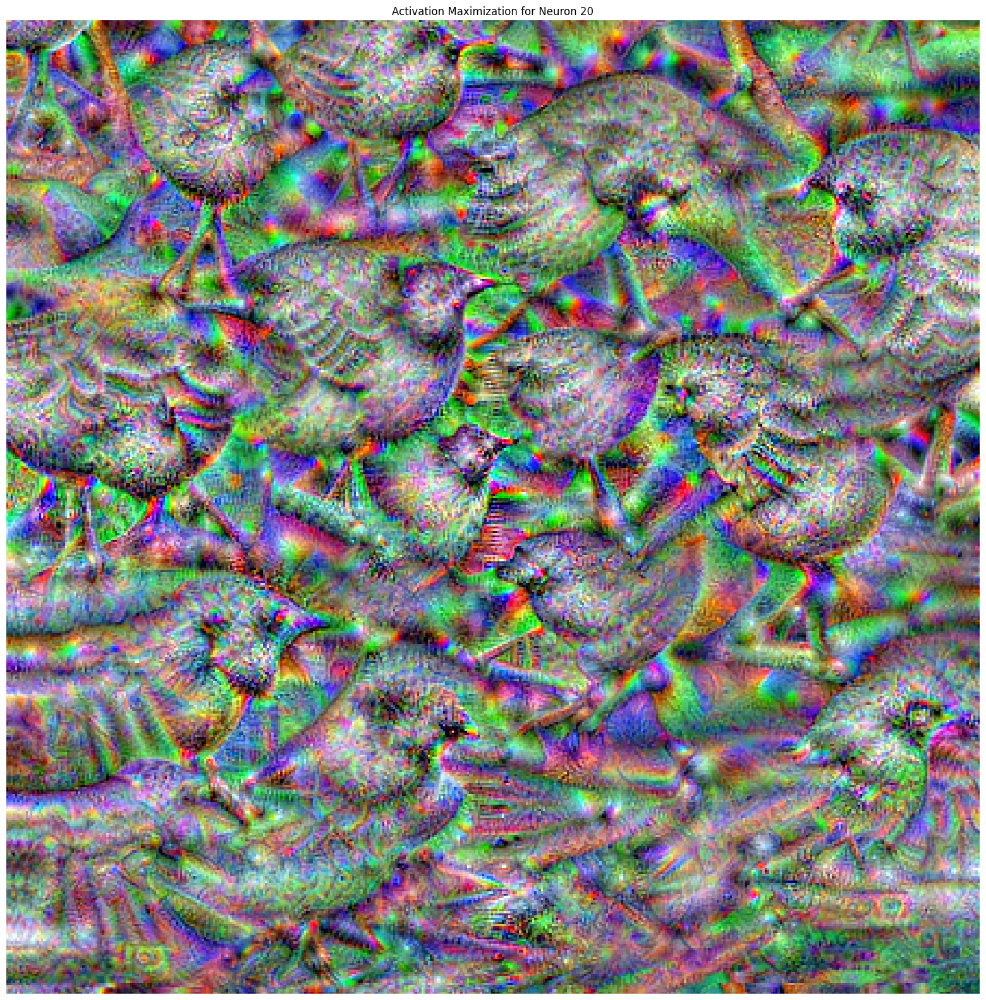

In [29]:
neuron_index = 20

# other indices to look at: 385: Indian elephant, 2: great white shark, 555: fire truck
# neuron_index = labels_names.index("Indian elephant")

activation_maximization = ActivationMaximization(model)
activation_maximization.visualize(neuron_index, num_iterations=2000, input_shape=(448, 448))

**Assignment**: You might want to play with this, e.g. 385: Indian elephant, 2: great white shark, 555: fire truck

Other classes can be found at:
[ImageNet](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a)

Iteration 0/2000, Activation: 0.6780961155891418, TotalVar: 6.346832275390625, TotalVar: 0.6712425351142883
Iteration 100/2000, Activation: 12.698452949523926, TotalVar: 1.6633533239364624, TotalVar: 0.5579944849014282
Iteration 200/2000, Activation: 25.002458572387695, TotalVar: 1.44028902053833, TotalVar: 0.5494083762168884
Iteration 300/2000, Activation: 55.63835144042969, TotalVar: 1.3533276319503784, TotalVar: 0.5479053258895874
Iteration 400/2000, Activation: 74.473388671875, TotalVar: 1.1966835260391235, TotalVar: 0.5431625843048096
Iteration 500/2000, Activation: 109.64641571044922, TotalVar: 1.1629770994186401, TotalVar: 0.5434985756874084
Iteration 600/2000, Activation: 152.89207458496094, TotalVar: 1.0741677284240723, TotalVar: 0.5437442660331726
Iteration 700/2000, Activation: 197.17181396484375, TotalVar: 0.968485951423645, TotalVar: 0.5427989959716797
Iteration 800/2000, Activation: 218.11537170410156, TotalVar: 0.9023294448852539, TotalVar: 0.5437049865722656
Iteration 9

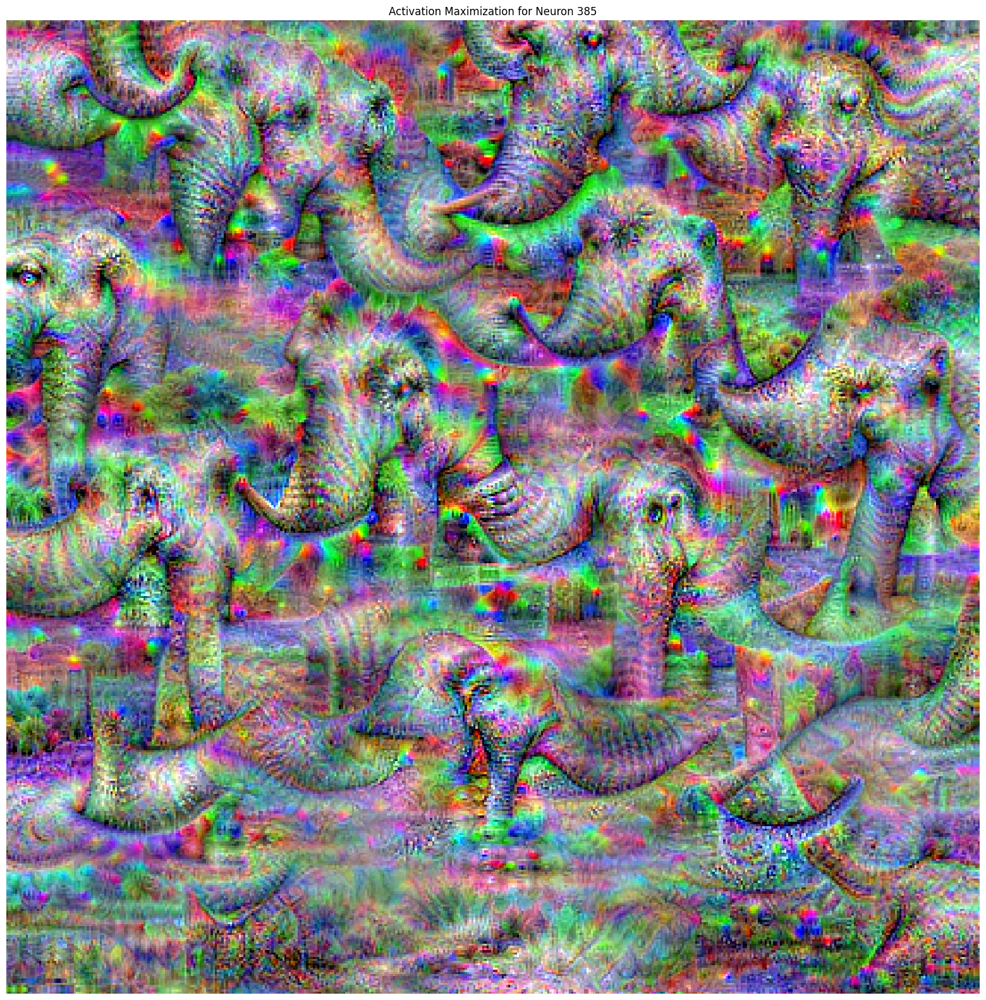

In [31]:
neuron_index = 385
activation_maximization.visualize(neuron_index, num_iterations=2000, input_shape=(448, 448))

Iteration 0/2000, Activation: -0.7837767004966736, TotalVar: 7.608270168304443, TotalVar: 0.7505322098731995
Iteration 100/2000, Activation: 1.6278027296066284, TotalVar: 2.1799919605255127, TotalVar: 0.5719417333602905
Iteration 200/2000, Activation: 10.155898094177246, TotalVar: 1.3057610988616943, TotalVar: 0.5407730937004089
Iteration 300/2000, Activation: 10.89897346496582, TotalVar: 1.174853801727295, TotalVar: 0.535174548625946
Iteration 400/2000, Activation: 23.975505828857422, TotalVar: 1.14103102684021, TotalVar: 0.5341467261314392
Iteration 500/2000, Activation: 38.07612991333008, TotalVar: 1.1361734867095947, TotalVar: 0.5337684154510498
Iteration 600/2000, Activation: 55.720947265625, TotalVar: 1.0079494714736938, TotalVar: 0.5305501818656921
Iteration 700/2000, Activation: 76.35099029541016, TotalVar: 1.0187493562698364, TotalVar: 0.5282937288284302
Iteration 800/2000, Activation: 76.39401245117188, TotalVar: 0.9475904107093811, TotalVar: 0.5212895274162292
Iteration 900/

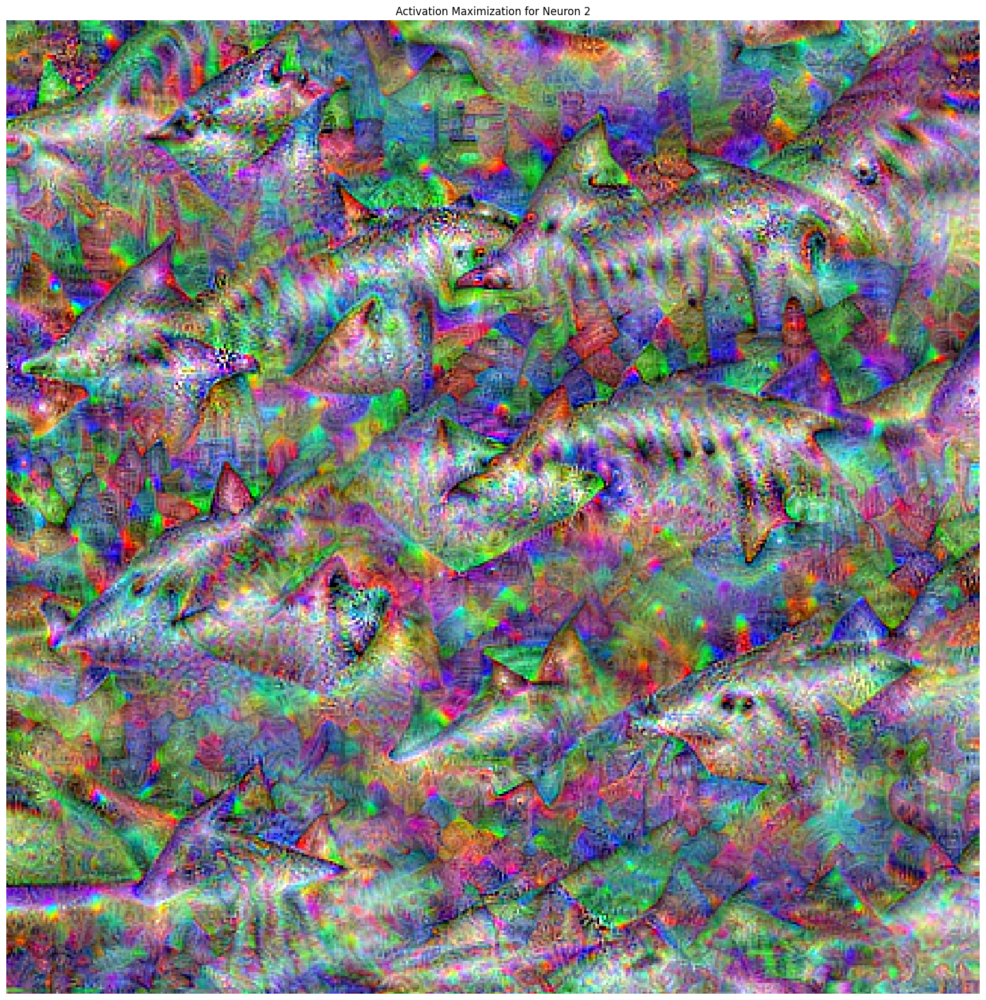

In [32]:
neuron_index = 2
activation_maximization.visualize(neuron_index, num_iterations=2000, input_shape=(448, 448))

Iteration 0/2000, Activation: 0.3377891182899475, TotalVar: 6.4216203689575195, TotalVar: 0.6771437525749207
Iteration 100/2000, Activation: 5.296356201171875, TotalVar: 1.5143983364105225, TotalVar: 0.5507094264030457
Iteration 200/2000, Activation: 14.194172859191895, TotalVar: 1.3849492073059082, TotalVar: 0.5459043979644775
Iteration 300/2000, Activation: 15.70185375213623, TotalVar: 1.254469871520996, TotalVar: 0.5393362641334534
Iteration 400/2000, Activation: 42.24448013305664, TotalVar: 1.2194703817367554, TotalVar: 0.5375193357467651
Iteration 500/2000, Activation: 35.46614456176758, TotalVar: 1.0392823219299316, TotalVar: 0.5317217707633972
Iteration 600/2000, Activation: 70.03266906738281, TotalVar: 1.073199987411499, TotalVar: 0.5323043465614319
Iteration 700/2000, Activation: 76.56829071044922, TotalVar: 0.9694446325302124, TotalVar: 0.5316448211669922
Iteration 800/2000, Activation: 95.24809265136719, TotalVar: 0.9372910261154175, TotalVar: 0.5301839113235474
Iteration 90

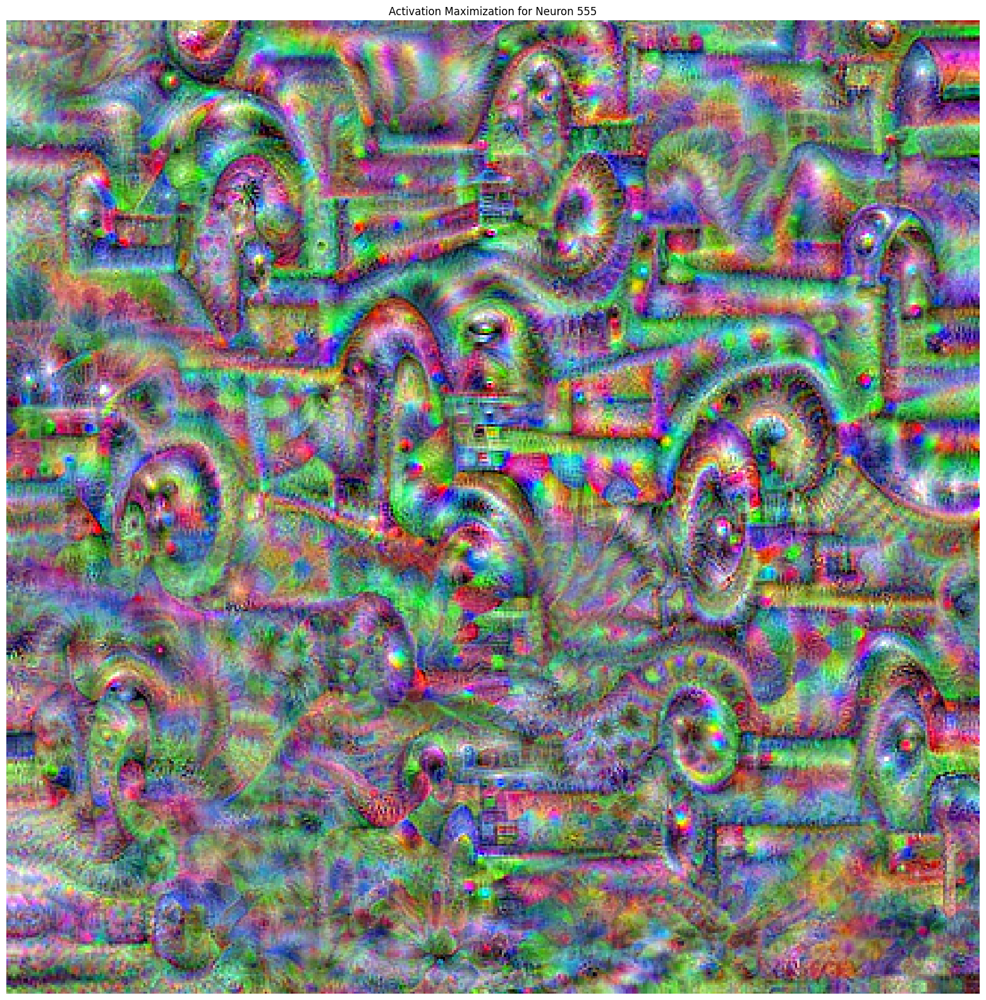

In [33]:
neuron_index = 555
activation_maximization.visualize(neuron_index, num_iterations=2000, input_shape=(448, 448))

**Assignment:** Generate the activation maximization image the the same index, for a network initialized randomly. What do you observe?


**Answer:** The maximized resulting "image" appears noisy and lacks structure, confirming that feature specialization only occurs after training.

Iteration 0/2000, Activation: -0.19457413256168365, TotalVar: 6.384302139282227, TotalVar: 0.671620786190033
Iteration 100/2000, Activation: -0.022692086175084114, TotalVar: 1.2251825332641602, TotalVar: 0.4748164713382721
Iteration 200/2000, Activation: 0.012245777994394302, TotalVar: 0.9087294936180115, TotalVar: 0.40726447105407715
Iteration 300/2000, Activation: 0.024721957743167877, TotalVar: 0.7100076079368591, TotalVar: 0.3503187298774719
Iteration 400/2000, Activation: 0.10979582369327545, TotalVar: 0.6153901815414429, TotalVar: 0.3102570176124573
Iteration 500/2000, Activation: 0.054087281227111816, TotalVar: 0.5527135133743286, TotalVar: 0.2754620909690857
Iteration 600/2000, Activation: 0.046440716832876205, TotalVar: 0.46738505363464355, TotalVar: 0.2426336407661438
Iteration 700/2000, Activation: 0.02941768616437912, TotalVar: 0.45624497532844543, TotalVar: 0.21461857855319977
Iteration 800/2000, Activation: 0.011587362736463547, TotalVar: 0.6222878694534302, TotalVar: 0.2

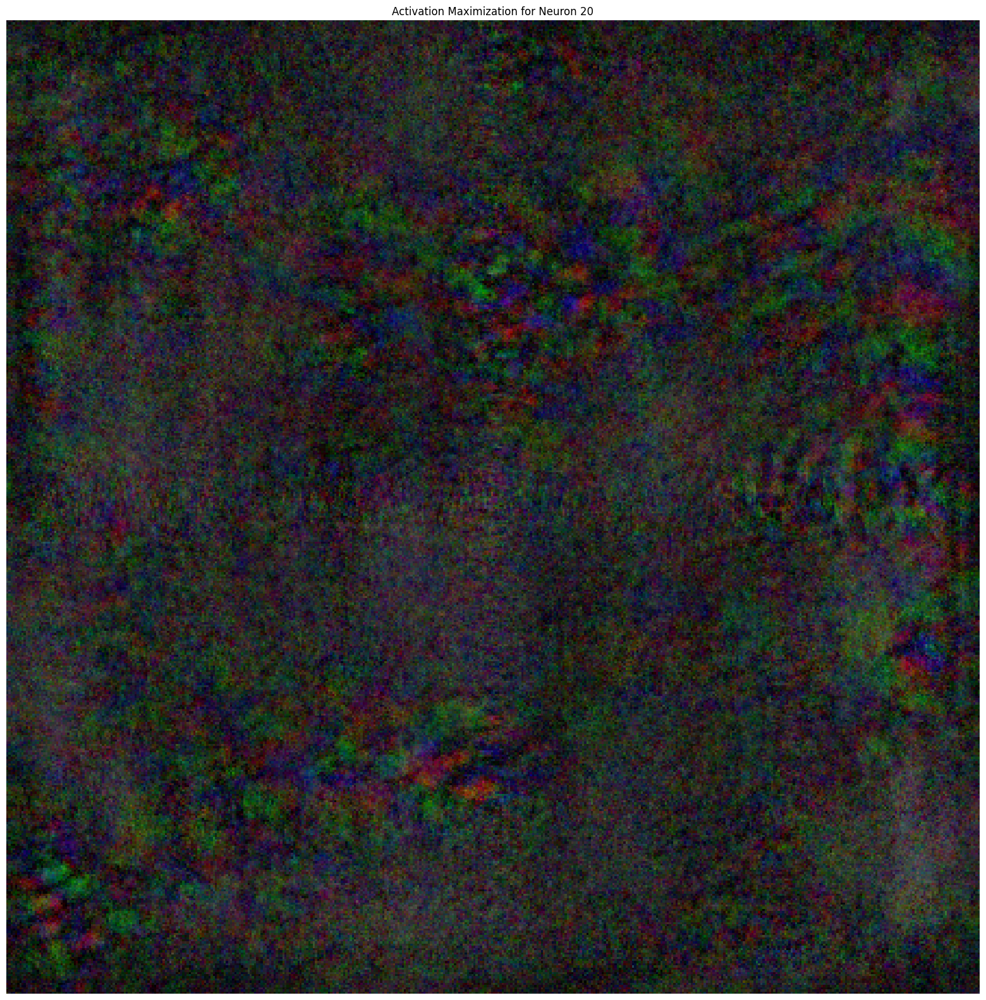

In [34]:
random_model = models.vgg16(weights=None).to(device).eval()

activation_maximization_random = ActivationMaximization(random_model)

neuron_index = 20

activation_maximization_random.visualize(neuron_index, num_iterations=2000, input_shape=(448, 448))


# Bonus: Visualizing Attention of a ViT Model

The attention mechanism in Vision Transformers (ViT) allows the model to focus on different parts of the input image. The attention weights can be interpreted as a matrix that indicates how much focus the model puts on each part of the image when making predictions.

### Mathematical Formulation

Let $ A $ be the attention matrix derived from the self-attention mechanism of a transformer layer, where:

$$
A = \text{Softmax}\left(\frac{QK^T}{\sqrt{d_k}}\right)
$$

- $Q$ is the query matrix,
- $K$ is the key matrix,
- $d_k$ is the dimensionality of the keys.

The output of the attention layer is simply the dot product $AV$, where $V$ is the value matrix.


In [ ]:
import cv2
from transformers import ViTForImageClassification, ViTFeatureExtractor

In [ ]:
# Load the ViT model and feature extractor
model = ViTForImageClassification.from_pretrained('google/vit-base-patch16-224')
feature_extractor = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
model.config.output_attentions = True

In [ ]:
# Load and prepare the image
image_path = './imagenet/418657219_3567961db1.jpg'
image = Image.open(image_path)
inputs = feature_extractor(images=image, return_tensors="pt")

# Pass the image through the model
outputs = model(**inputs)

In [ ]:
# Extract attention weights
attn_weights = outputs.attentions
attn_weights = torch.stack(attn_weights).squeeze(1)
attn_weights = torch.mean(attn_weights, dim=1) # Average across attention heads in Multi-attention Layers

# Check the shape of the attention weights
print("Shape of attention weights:", attn_weights.shape) # The model is composed of 12 Attention Layers

### Attention Rollout Process

To visualize the contributions of different layers to the final output, we perform an attention rollout.
At every Transformer block, we get an attention Matrix $(A)_{ij}$ that defines how much attention is going to flow from token j in the previous layer to token i in the next layer.
Attention rollout process involves recursively multiplying the attention matrices across multiple layers.
To account for the residual connections, we can add the identity matrix $I$ to the Attention matrices: $A + I$.

Let $A^{l}$ be the attention matrix from layer $l$. The rollout $R$ at layer $l$ is computed as follows:

1. Initialize $R^{0}$ as the attention matrix of the first layer:
   $$
   R^{0} = A^{0}
   $$

2. For each following layer $l$:
   $$
   R^{l} = (A^{l} + I) R^{l-1}
   $$
where $I$ is the Identity matrix.

Let $L$ denotes the index of the last layer. The final rollout $R^{L}_{0}$ can be interpreted as a joint attention representation that indicates how each token attends to every other token throughout the network.

$R^{L}$ can be normalized to obtain a mask:

$$
\text{mask} = \frac{R^{L}_{0}}{\max(R^{L}_{0})}
$$



In [ ]:
# Add an identity matrix for bias
residual_att = torch.eye(attn_weights.size(1))
aug_att_mat = attn_weights + residual_att
aug_att_mat = aug_att_mat / aug_att_mat.sum(dim=-1).unsqueeze(-1)

# Recursively multiply the weight matrices
rollout_attentions = torch.zeros(aug_att_mat.size())
rollout_attentions[0] = aug_att_mat[0]
for n in range(1, aug_att_mat.size(0)):
    rollout_attentions[n] = torch.matmul(aug_att_mat[n], rollout_attentions[n-1])

# Attention from the output to the input space
R = rollout_attentions[-1]
grid_size = int(np.sqrt(aug_att_mat.size(-1)))
mask = R[0, 1:].reshape(grid_size, grid_size).detach().numpy()
mask = cv2.resize(mask / mask.max(), image.size)[..., np.newaxis]


In [ ]:
# Resize the CAM and overlay it
result = overlay_mask(image, to_pil_image(mask, mode='F'), alpha=0.5)
# Display it
plt.imshow(result); plt.axis('off'); plt.tight_layout(); plt.show()

**Assignment:** The attention rollout mechanism in ViTs is not class-specific. Could you propose a modification of this mechanism to make it class-specific, drawing inspiration from methods like Grad-CAM?